Sinusoid
===

Sinusoids are used for all sorts of signal models in Electrical & Computer Engineering (ECE).  It is hard to overstate their importance in ECE.

The basic sinusoid is a sine or cosine function over time.

$$ X(t) = A \cos(\omega t+\theta)$$

where

* $A$ is the *amplitude* of the sinusoid.
* $\omega$ is the *frequency* (in radians per second).  $\omega=2\pi f$ where $f$ is the frequency in cycles per second (Hertz, abbreviated Hz).
* $f=1/T$ where $T$ is the *period* of the sinusoid, i.e., the sinusoid repeats every $T$ seconds.
* $\theta$ is a *phase offset*, in radians. 

Note,

$$\cos(\omega t+\theta) = \sin(\omega t +\theta+\pi/2)$$

So we can use either $\cos$ or $\sin$ as our basic function.
<br><br>


In [1]:
%matplotlib inline
from IPython.display import Audio, Image
#from __future__ import division 
from numpy import pi,sin,exp,cos
import numpy as np
import matplotlib.pylab as plt

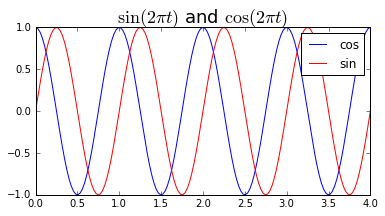

In [2]:
plt.figure(figsize=(6,3))
t=np.linspace(0,4,151) #lots of points
f=1
w=2*pi*f

plt.plot(t,cos(w*t),'b',label='cos')
plt.plot(t,sin(w*t),'r',label='sin')
plt.title('$\sin(2\pi t)$ and $\cos(2\pi t)$',size=18)
plt.legend()

Lissajous Figures
---
Rememeber the day in physics lab, wave generator could generate interesting plots, called sinusoid with different frequencies for $X$ axis and $Y$ axis. Vary the frequencies and phase to get a variety of interesting pictures. 

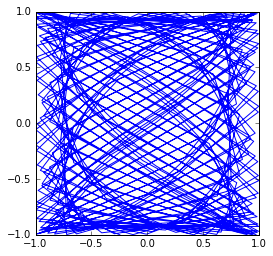

In [3]:
wt = np.linspace(0,100*pi,300)

a=np.sqrt(2)
b=3/4
X=cos(a*wt)
Y=cos(b*wt)
#plt.xlim(X.min() * 1.1, X.max() * 1.1)
#plt.ylim(Y.min() * 1.1, Y.max() * 1.1)
plt.plot(X,Y)
#plt.axes().axis('off') #eliminate the box
plt.axes().set_aspect('equal')

Frequencies Range
---
Frequencies in applications vary across many orders of magnitude, high and low:

* Audio: 
    * Audible frequencies from 20 Hz to 20,000 Hz
    * A above middle C: 440 Hz
* Ultrasound Imaging: about 2 MHz
* Power:
    * 60 Hz in Taiwan;
    * 50 Hz in many other countries, Japan for instance.
* Radio: 
    * AM Broadcast: about 1 MHz
    * FM Broadcast: about 100 MHz
    * Wifi: about 2.4 GHz
    * Microwave Oven: 2.45 GHz
    * UD Research: up to 100 Ghz

Complex Numbers and Euler's Formula
---
In analyzing sinusoids, we make great use of complex numbers.

$$z = x + jy = |z|e^{j \theta}$$

where $|z| = \sqrt{x^2+y^2}$, $\theta = \tan^{-1}(y/x)$, $x=\operatorname{Re}(z)$, and  $y=\operatorname{Im}(z)$.

$$\begin{align}
z_1 + z_2 &= (x_1 + x_2) + j(y_1+y_2)\\
z_1 z_2 &= (x_1x_2 -y_1y_2) + j(x_1y_2 + x_2y_1)\\
  &= |z_1||z_2| e^{j(\theta_1+\theta_2)}
\end{align}$$

We use this simple formula below to do a hard computation:

$$\operatorname{Re}(z_1) + \operatorname{Re}(z_2) = \operatorname{Re}(z_1+z_2)$$

Perhaps the most important single formula in all of mathematics is *Euler's Formula*:

$$\mathbf{e^{j\theta} = \cos(\theta) + j\sin(\theta)}$$

Using Euler's formula, we can also write a complex number as

$$z = |z| e^{j\theta}$$
where $\theta=\angle z$ is the angle of $z$.

With $\theta=\pi$, Euler's formula can be rearranged as

$$ e^{j\pi}+1=0$$

Thus combining the five most important mathematical values into one simple equation.

<br><br>

While we use sinusoids in lots of areas, we don't use trigonometry.  We use complex variables and Euler's formula.

Euler's formula gives us simple formula for sinusiods:

$$e^{j\omega t} = \cos(\omega t) + j\sin(\omega t)$$

Using Euler's formula, we can write sinusoids two different ways:

$$\cos(\omega t) = \operatorname{Re}(e^{j\omega t}) = \frac{e^{j\omega t} + e^{-j\omega t}}{2} $$

Using the $\operatorname{Re}(e^{j\omega t})$ is especially handy when we add sinusoids together and the second formula when multiplying sinusoids.

Here's an example of adding two sinusoids (with the same frequency):

$$\begin{align}
\cos(\omega t) + 2\cos(\omega t + \pi/4) &= \operatorname{Re}(e^{j\omega t}) + \operatorname{Re}(2 e^{j\omega t+j\pi/4})\\
  &= \operatorname{Re}(e^{j\omega t}+2 e^{j\omega t+j\pi/4})\\
  &= \operatorname{Re}((1+2 e^{j\pi/4})e^{j \omega t})
\end{align}$$

Now add the two complex numbers together and convert to polar notation:


Beat Frequency
---
Add two sinusoids with different frequencies:

$$\cos(\omega_1 t) + \cos(\omega_2 t) = 2 \cos\big((\omega_1-\omega_2)t/2\big)\cos\big((\omega_1+\omega_2)t/2\big)$$

$\omega_1-\omega_2$ is the *beat* frequency.  

Guitar tuners adjust one note until the beat frequency against a reference is 0.

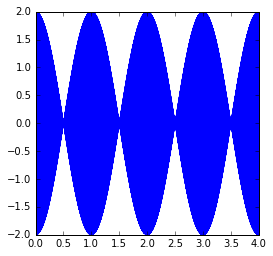

In [7]:
Fs = 22050
f1 = 440
f2 = 441
t = np.linspace(0, 4, 4*Fs)
plt.plot(t,cos(2*pi*f1*t) + cos(2*pi*f2*t))
plt.axes().set_aspect('equal')

Audio by IPython
---
Not only the plotting capacity brought by matplotlib, Audio availed by IPython can play music now.

In [8]:
Fs = 22050
f1 = 440
f2 = 441
t = np.linspace(0, 4, 4*Fs)
sound = cos(2*pi*f1*t) + cos(2*pi*f2*t)
Audio(sound, rate=Fs)

Frequency Shifting
---
Multiplying two sinusoids results in a frequency shift:

$$\cos(\omega_1 t) \cos(\omega_2 t) = \frac{\cos((\omega_1+\omega_2)t)}{2} + \frac{\cos((\omega_2-\omega_1)t)}{2}$$

This is how radio transmits a signal.  $\omega_1$ represents the sound (typically a small frequency) and $\omega_2$ the radio carrier frequency (typically much higher).


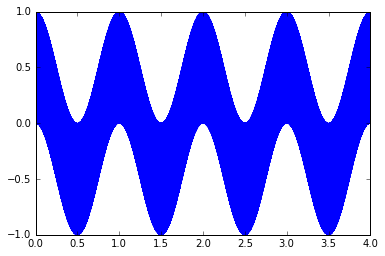

In [9]:
Fs = 22050
f1 = 440
f2 = 441
t = np.linspace(0, 4, 4*Fs)
plt.plot(t,cos(2*pi*f1*t) * cos(2*pi*f2*t))

In [10]:
Fs = 22050
f1 = 440
f2 = 441
t = np.linspace(0, 4, 4*Fs)
sound = cos(2*pi*f1*t) * cos(2*pi*f2*t)
Audio(sound, rate=Fs)

Music Notes
---
Music frequencies are exponential.  Each octave is a doubling in frequency.

E.g., Note A can be 55 Hz, 110 Hz, 220 Hz, 440 Hz, 880 Hz, etc.

$$A = 440*2^{m-4}$$

where $m$ is octave number.  $m=4$ is the standard middle octave.

Music Scales
---
The conventional scale in western music consists of semitones $2^{1/12}$ apart.

In [11]:
2**(1/12)

1.0594630943592953

There are 12 semitones per octave,

$$ (2^{(1/12)})^{12} = 2$$

MIDI Note Numbers
---
<img src="imgs/MIDINum.png" width=90% caption="MIDI" />

The major notes (white piano keys) are C, D, E, F, G, A, B, C5 (C5 is note C in the next octave.)

The MIDI note number for A above middle C is $n=69$. 

|Note|	Frequency (Hz)|	Wavelength (cm)|
|:---:|:---:|:---:|
|$C_0$	|16.35	|2109.89|
| $C^\hbox{#}_0$/$D^b_0$ |	17.32|	1991.47|
|$D_0$|	18.35	|1879.69|
 |$D^\hbox{#}_0$/$E^b_0$ | 	19.45	|1774.20|
|$E_0$|	20.60|	1674.62|
|$F_0$	|21.83	|1580.63|
| $F^\hbox{#}_0$/$G^b_0$ |	23.12	|1491.91|
|$G_0$|	24.50	|1408.18|
| $G^\hbox{#}_0$/$A^b_0$ 	|25.96	|1329.14|
|$A_0$	|27.50|	1254.55|
|$A^\hbox{#}_0$/$B^b_0$ |	29.14	|1184.13|
|$B_0$|	30.87	|1117.67|
|$C_1$	|32.70	|1054.94|
| $C^\hbox{#}_1$/$D^b_1$|	34.65	|995.73|
|$D_1$	|36.71	|939.85|
| $D^\hbox{#}_1$/$E^b_1$ |	38.89	|887.10|
|$E_1$	|41.20	|837.31|
|$F_1$	|43.65	|790.31|
| $F^\hbox{#}_1$/$G^b_1$ |	46.25	|745.96|
|$G_1$	|49.00	|704.09|
| $G^\hbox{#}_1$/$A^b_1 $|	51.91	|664.57|
|$A_1$	|55.00|	627.27|
|$A^\hbox{#}_1$/$B^b_1$ |	58.27	|592.07|
|$B_1$	|61.74|	558.84|
|$C_2$	|65.41|	527.47|
| $C^\hbox{#}_2$/$D^b_2$ |	69.30|	497.87|
|$D_2$	|73.42|	469.92|
 |$D^\hbox{#}_2$/$E^b_2$ |	77.78|	443.55|
|$E_2$	|82.41|	418.65|
|$F_2$	|87.31|	395.16|
 |$F^\hbox{#}_2$/$G^b_2$ |	92.50|	372.98|
|$G_2$	|98.00|	352.04|
 |$G^\hbox{#}_2$/$A^b_2 $|	103.83	|332.29|
|$A_2$	|110.00|	313.64|
| $A^\hbox{#}_2$/$B^b_2$	|116.54	|296.03|
|$B_2$	|123.47	|279.42|
|$C_3$	|130.81	|263.74|
 |$C^\hbox{#}_3$/$D^b_3$	|138.59	|248.93|
|$D_3$	|146.83|	234.96|
 |$D^\hbox{#}_3$/$E^b_3$  |	155.56	|221.77|
|$E_3$	|164.81	|209.33|
|$F_3$	|174.61	|197.58|
| $F^\hbox{#}_3$/$G^b_3$	|185.00	|186.49|
|$G_3$	|196.00	|176.02|
 |$G^\hbox{#}_3$/$A^b_3 $	|207.65|	166.14|
|$A_3$	|220.00	|156.82|
 |$A^\hbox{#}_3$/$B^b_3$ |	233.08|	148.02|
|$B_3$|	246.94	|139.71|
|$C_4$	|261.63|	131.87|
| $C^\hbox{#}_4$/$D^b_4$ |	277.18	|124.47|
|$D_4$	|293.66	|117.48|
| $D^\hbox{#}_4$/$E^b_4$  |	311.13	|110.89|
|$E_4$	|329.63|	104.66|
|$F_4$	|349.23|	98.79|
| $F^\hbox{#}_4$/$G^b_4$|	369.99|	93.24|
|$G_4$	|392.00|	88.01|
| $G^\hbox{#}_4$/$A^b_4 $|	415.30	|83.07|
|$A_4$	|440.00	|78.41|
| $A^\hbox{#}_4$/$B^b_4$|	466.16	|74.01|
|$B_4$	|493.88	|69.85|
|$C_5$	|523.25	|65.93|
| $C^\hbox{#}_5$/$D^b_5$| 	554.37|	62.23|
|$D_5$	|587.33	|58.74|
| $D^\hbox{#}_5$/$E^b_5$ |	622.25|	55.44|
|$E_5$	|659.25	|52.33|
|$F_5$	|698.46|	49.39|
| $F^\hbox{#}_5$/$G^b_5$ |	739.99	|46.62|
|$G_5$	|783.99	|44.01|
 |$G^\hbox{#}_5$/$A^b_5 $|	830.61	|41.54|
|$A_5$	|880.00|	39.20|
| $A^\hbox{#}_5$/$B^b_5$	|932.33	|37.00|
|$B_5$	|987.77	|34.93|
|$C_6$|	1046.50	|32.97|
| $C^\hbox{#}_6$/$D^b_6$ |	1108.73	|31.12|
|$D_6$|	1174.66|	29.37|
| $D^\hbox{#}_6$/$E^b_6$ |	1244.51	|27.72|
|$E_6$	|1318.51|	26.17|
|$F_6$	|1396.91|	24.70|
| $F^\hbox{#}_6$/$G^b_6$|	1479.98	|23.31|
|$G_6$	|1567.98|	22.00|
| $G^\hbox{#}_6$/$A^b_6 $|	1661.22	|20.77|
|$A_6$	|1760.00|	19.60|
 |$A^\hbox{#}_6$/$B^b_6$ |	1864.66	|18.50|
|$B_6$	|1975.53|	17.46|
|$C_7$	|2093.00|	16.48|
| $C^\hbox{#}_7$/$D^b_7$|	2217.46	|15.56|
|$D_7$	|2349.32|	14.69|
| $D^\hbox{#}_7$/$E^b_7$  |	2489.02	|13.86|
|$E_7$	|2637.02	|13.08|
|$F_7$	|2793.83|	12.35|
| $F^\hbox{#}_7$/$G^b_7$ |	2959.96|	11.66|
|$G_7$	|3135.96	|11.00|
| $G^\hbox{#}_7$/$A^b_7 $|	3322.44	|10.38|
|$A_7$	|3520.00|	9.80|
 |$A^\hbox{#}_7$/$B^b_7$	|3729.31	|9.25|
|$B_7$|	3951.07|	8.73|
|$C_8$|	4186.01	|8.24|
| $C^\hbox{#}_8$/$D^b_8$|	4434.92	|7.78|
|$D_8$	|4698.63|	7.34|
|$D^\hbox{#}_8$/$E^b_8$ 	|4978.03	|6.93|
|$E_8$	|5274.04|	6.54|
|$F_8$	|5587.65|	6.17|
 |$F^\hbox{#}_8$/$G^b_8$ |	5919.91|	5.83|
|$G_8$|	6271.93|	5.50|
 |$G^\hbox{#}_8$/$A^b_8 $	|6644.88	|5.19|
|$A_8$	|7040.00|	4.90|
 |$A^\hbox{#}_8$/$B^b_8$	|7458.62|	4.63|
|$B_8$	|7902.13	|4.37|


In [23]:
G3,A,B4b,B, C, D, E, F, G, A5,B5b, B5, C5,D5,E5,F5,G5,A6,B6, C6 = 55,57,58,59,\
          60, 62, 64, 65, 67, 69, 70,71, 72,74,76,77,79,81,83,84
scale = [C, D, E, F, G, A, B, C5 ,D5, E5,F5,G5,A6,B6,C6 ]

Look as Piano is:
<img src="imgs/piano.jpg" width=40% />

In [3]:
# Let's play some sounds.  First, A above middle C:
Fs = 22050 #samplerate
dur = 3 #note duration in seconds
t = np.linspace(0,dur,dur*Fs)
f = 440
Audio(sin(2*pi*f*t), rate=Fs)

In [5]:
# Now let's play a scale:
BaseNote = 440
sound = []
for note in scale:
    f = BaseNote * 2**((note-69)/12)
    sound.append(sin(2*pi*f*t))
sound = np.concatenate(sound)
Audio(sound, rate=Fs)

Envelope Functions
---
The notes sound better if we apply an *envelope* function to soften the rise and fall.  Professional envelopes use an ADSR (Attack, Delay, Sustain, Release) shape, but we will start simply.

The sine function starts at 0, rises to 1 (at pi/2), and returns to 0 (at pi). 

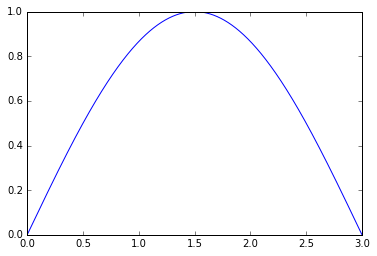

In [4]:
def sine_env(t):
    return sin(pi*t/t[-1]) #t[-1] = last value
plt.plot(t,sine_env(t))

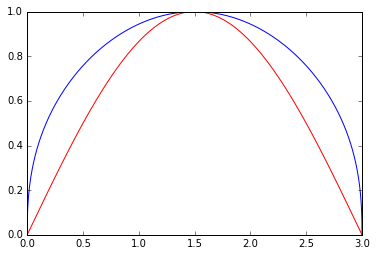

In [5]:
# That works, but even better is to make it flatter.  Here's a trick:
def flute_env(t):
    return sin(pi*t/t[-1])**0.4
plt.plot(t,flute_env(t),'b')
plt.plot(t,sine_env(t), 'r')

All the code snippets have the same basic structure. sound=[] is an empty list. For each note in the song, the frequency is computed, a sinusoid of that frequency is created, and the sinusoid is appended to the list. When the for loop exits, the list of sounds is concatenated into a single longer sound. That sound is played with the Audio command.

In [8]:
BaseNote = 440

sound = []
for note in scale:
    f = BaseNote * 2**((note-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(flute_env(t) * sinusoid)
    
sound = np.concatenate(sound)
Audio(sound, rate=Fs)

The sound from a stringed instrument (e.g., guitar or piano) rises quickly, then decreases slowly.


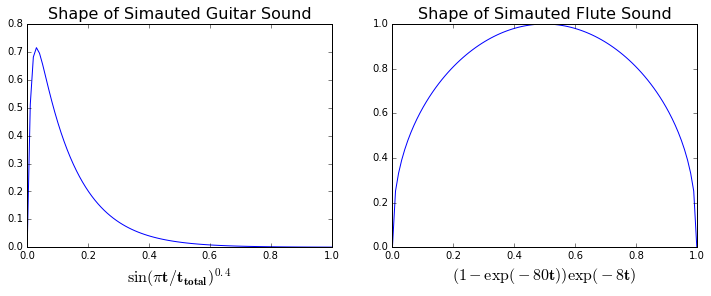

In [6]:
def sine_env(t):
    return sin(pi*t/t[-1]) #t[-1] = last value
#plt.plot(t,sine_env(t))
def flute_env(t):
    return sin(pi*t/t[-1])**0.4
def guitar_env(t):
    return (1-exp(-80*t))*exp(-8*t)

t=np.linspace(0,1,100)
plt.figure(figsize=(12,4))
plt.subplot(121)
plt.plot(t,guitar_env(t))
plt.xlabel(r'$\mathbf{\sin(\pi t/t_{total})^{0.4}}$',size=16)
plt.title('Shape of Simauted Guitar Sound',size=16)
plt.subplot(122)
plt.plot(t,flute_env(t))
plt.title('Shape of Simauted Flute Sound',size=16)
plt.xlabel(r'$\mathbf{(1-\exp(-80t))\exp(-8t)}$',size=16)

Here's an illustration of the guitar envelope times the sinusiod. The rise is very quick, almost impossible to see, but the decay is clear.

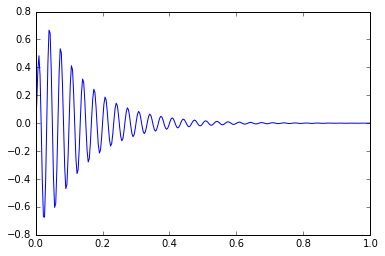

In [20]:
s = np.linspace(0,1,300)
plt.plot(s,guitar_env(s)*sin(2*pi*30*s))

In [10]:
BaseNote = 440
dur = 0.5

sound = []
t = np.linspace(0,dur,dur*Fs)
for note in scale:
    f = BaseNote * 2**((note-69)/12)
    sinusoid = cos(2*pi*f*t)
    sound.append(guitar_env(t) * sinusoid)

sound = np.concatenate(sound)
Audio(sound, rate=Fs)

Mary Had a Little Lamb
---
Let's play a song. Since the notes have different durations, we need to modify our code a bit. Each note has a frequency and duration. The song is a list of notes. When we create the song, we will loop over the notes.

In [11]:
mary = [ (E, 1/2), (D, 1/2), (C, 1/2), (D, 1/2), (E, 1/2), (E, 1/2), 
        (E, 1), (D, 1/2), (D, 1/2), (D, 1), (E, 1/2), (G, 1/2),
        (G, 1), (E, 1/2), (D, 1/2), (C, 1/2), (D, 1/2), (E, 1/2),
        (E, 1/2), (E, 1/2), (E, 1/2), (D, 1/2), (D, 1/2), (E, 1/2),
        (D, 1/2), (C, 1)]

In [43]:
BaseNote = 440

sound = []
for note in mary:
    fnum, dur = note
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(guitar_env(t) * sinusoid)
    
mary_guitar_sound = np.concatenate(sound)
Audio(mary_guitar_sound, rate=Fs)

In [44]:
BaseNote = 880

sound = []
for note in mary:
    fnum, dur = note
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(flute_env(t) * sinusoid)
    
mary_flute_sound = np.concatenate(sound)

Audio(mary_flute_sound, rate=Fs)

In [14]:
sound = mary_guitar_sound+0.3*mary_flute_sound
Audio(sound, rate=Fs)

Taiwan's Folk: Rain falling down the tunnel
---

In [15]:
train=[(D5,1),(E5,1), (D5,1/2),(E5,1/2),(D5,1/2),(C5,1/2),
       (D5,1/2),(E5,1/4),(E5,1/4),(D5,1/2),(C5,1/2),(D5,1),(C5,1/2),(A5,1/2),
       (G,1/2),(G,1/2),(A5,1/2),(C5,1/2),(G,2),
       (A5,1),(D5,1),(A5,1/2),(C5,1/2),(C5,1/2),(A,1/2),
       (D5,1/2),(C5,1/4),(D5,1/2),(C5,1/4),
       (A5,1/2),(C5,1/2),(A5,1/2),(C5,1/2),
       (G,1/2),(G,1/4),(G,1/4),(G,1/2),(G,1/2),
       (A5,1/2),(C5,1/2),(A5,1/2),(G,1/2),(D,3/2),(A5,1/2),(G,2)]

In [16]:
# Solo by flute
BaseNote = 466.16

sound = []
for note in train:
    fnum, dur = note
    t = np.linspace(0,dur/2,dur/2*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    #sound.append(guitar_env(t) * sinusoid)
    sound.append(flute_env(t) * sinusoid)
train_guitar_sound = np.concatenate(sound)
Audio(train_guitar_sound, rate=Fs)

In [17]:
# Duo cconcert by playing by  Flute and guiter
BaseNote = 466.16

sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(guitar_env(t) * sinusoid)
    #sound.append(flute_env(t) * sinusoid)
gsound = np.concatenate(sound)
sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(flute_env(t) * sinusoid)
    
train_flute_sound= np.concatenate(sound)
train_duo_sound = 0.7*train_guitar_sound+1*train_flute_sound

Audio(train_duo_sound, rate=Fs)

Beatles: Norwegian Wood
---

In [24]:
##### B3b=233.08
BaseNote=293.66
beatles=[(G,1),(B5,1/2),(G,1/2),(F,1/4),(E,1/4),(E,1),(0,1/2),(D,1/2),(F,1/4),(E,1/2),
        (C,1),(0,1/2),(B4b,1/2),(F,1/2),(A,1/2),(G3,1),(0,1/2),(0,1),
        (G,1),(A,1/2),(G,1/2),(F,1/2),(E,1),(D,1/2),(F,1/2),(E,1/2),(C,1),(0,1/2),(B4b,1/2),(F,1/2),(A,1/2),
        (G3,1),(0,1/2),(0,1),(A,1/2),(E,1/2),(E,1/2),(E,1/2),(E,1/2),(D,1/2),(D,1/2),
        (D,1/2),(C,1/2),(C,1/2),(C,1/4),(D,1/2),(C,1/4),(C,1/4),(D,1),(0,1),(0,1),(0,1),(G3,1/2),
        (E,1/2),(E,1/2),(E,1/2),(E,1/2),(D,1/2),(D,1/2),
        (D,1/2),(C,1/2),(C,1/2),(C,1/4),(D,1/2),(C,1/4),(C,1/4),(D,1),(0,1),(0,1),(0,1),
        (G,1),(A,1/2),(G,1/2),(F,1/2),(E,1),(0,1/2),(D,1/2),(F,1/2),(E,1/2),(C,1),(0,1/2),(B4b,1/2),(F,1/2),(A,1/2),
        (G3,1),(0,1),
        (G,1),(A,1/2),(G,1/2),(F,1/2),(E,1),(0,1/2),(D,1/2),(F,1/2),(E,1/2),(C,1),(0,1/2),(B4b,1/2),(F,1/2),(A,1/4),
        (G3,1/4),(G3,1),(0,1),
        (G5,1),(G5,1/4),(A6,1/4),(G5,1/2),(F5,1/2),(E5,1),(D5,1/2),(E5,1/4),(F5,1/3),(E5,1/2),(C5,1),(B5b,1/2),
        (F5,1/2),(A5,1/2),
        (G,1),(G,1),(G,1),(G,1),(B,1/2),(G5,1),(G5,1/4),(A6,1/4),(G5,1/2),(F5,1/2),(E5,1),(D5,1/2),(E5,1/4),(F5,1/3),(E5,1/2),(C5,1),(B5b,1/2),
        (F5,1/2),(A5,1/2),(G,1),(G,1)]

In [32]:

sound = []
for note in beatles:
    fnum, dur = note
    dur=dur/1.333
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    FMsinusoid = cos(2*pi*f*t + 5*sin(4.1*pi*f*t))
    sound.append(guitar_env(t) * sinusoid*FMsinusoid)
    #sound.append(flute_env(t) * sinusoid)
gsound = np.concatenate(sound)

Audio(gsound, rate=Fs)

Sound of Silence
---

In [18]:
silence=[(A5,1/2),(A5,1/2),(C5,1/2),(C5,1/2),(E5,1/2),(E5,1/2),(D5,4),
        (0,1/2),(G,1/2), (G,1/2),(G,1/2),(B5,1/2),(B5,1/2),(D5,1/2),(D5,1/2),
        (C5,4),(0,1/2),(C5,1/2),(C5,1/2),(C5,1/2),(E5,1/2),(E5,1/2),(G5,1/2),(G5,1/2),(A6,2),(G5,2),
        (0,1/2),(C5,1/2),(C5,1/2),(C5,1/2),(E5,1/2),(E5,1/2),(G5,1/2),(G5,1/2),(A6,2),(G5,2),
        (A6,1),(A6,1/2),(B6,1/2),(C6,1/2),(C6,1/2),(C6,1),
        (B6,1/2),(A6,1),(A6,1/2),(G5,2),(G5,1),(A6,1/2),(G5,1/2),(E5,2),
        (E5,2),(0,1/2),(C5,1/2),(C5,1/2),(C5,1/2),(G5,3),(0,1/2),(B5,1/2),(C5,1/2),(A5,1/2),(A5,3)]

In [41]:
# playing by  Flute and guiter
BaseNote = 415.3

sound = []
for note in silence:
    fnum, dur = note
    dur=dur
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(guitar_env(t) * sinusoid)
    #sound.append(flute_env(t) * sinusoid)
silence_guitar_sound = np.concatenate(sound)
sound = []
for note in silence:
    fnum, dur = note
    dur=dur
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    sound.append(flute_env(t) * sinusoid)
    
silence_flute_sound = np.concatenate(sound)
silence_duo_sound = silence_guitar_sound+1*silence_flute_sound

Audio(silence_duo_sound, rate=Fs)

Playing Euler Number
---
$$
\mathbf{e = 2.718 281 828 459 045 235 360 287 4713 527\cdots}
$$

In [32]:
# e = 2.7182818284590452353602874 7135 2662 4977 5724 7093 6999 ...
euler=[(D,1),(B5,1),(C,1),(C5,1),(D,1),(C5,1),(C,1/2),(C5,1/2),(D,1/2),(C5,1/2),(F,1),(G,1),(D5,1),(0,1),
    (F,1),(G,1),(D,1),(E,1),(G,1),(E,1),(D,1),(0,1),(G,1/2),(E,1/2),(A5,1),(0,1),(D,1),(C5,1),(B5,1),(F,1),
    (B5,1/2),(C,1/2),(E,1/2),(G,1/2),(D,1),(A5,1),(A5,1),(D,1),(F,1),(D5,1),(B5,1),(B5,1),
    (G,1),(B5,1),(D,1),(F,1),(B5,1),(0,1),(D5,1),(E,1),(A5,1),(D5,1/2),(D5,1/2),(D5,1/2)]
BaseNote = 466.16

sound = []
for note in euler:
    fnum, dur = note
    t = np.linspace(0,dur/2,dur/2*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    #sound.append(guitar_env(t) * sinusoid)
    sound.append(flute_env(t) * sinusoid)
gsound = np.concatenate(sound)

Audio(gsound, rate=Fs)


FM Modulation
---
Frequency modulation makes for an interesting sound.
$X(t)=\cos(2 \pi f t+k\sin(2\pi f_m t))$
Yamaha synthesizers were famous for their FM sound.
The snippet and plot below illustrate FM modulation. See how the frequency increases and decreases.

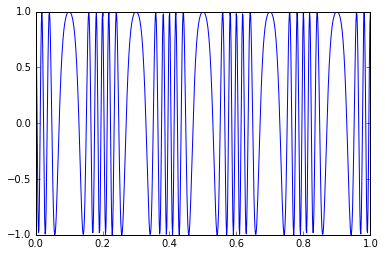

In [33]:
s = np.linspace(0,1,700)
plt.plot(s, cos(2*pi*30*s + 5*sin(2*pi*5*s)) ) 

In [46]:
BaseNote = 220

fmsound = []
for note in mary:
    fnum, dur = note
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    FMsinusoid = cos(2*pi*f*t + 10*sin(4.1*pi*f*t)) 
    fmsound.append( guitar_env(t) * FMsinusoid )
    
fmsound = np.concatenate(fmsound)
Audio(fmsound, rate=Fs)

In [47]:
sound = fmsound+0.5*mary_flute_sound
Audio(sound, rate=Fs)

AM Modulation or *Tremolo*
---
Tremolo is an amplitude modulation of the note. The envelope has ripples. We must keep the tremolo frequency below the lower limit of hearing, 20 Hz.

$$X(t)=(1+d\sin(2\pi f_rt))\cos(2\pi f t)$$
$d$ is the depth of the tremolo.

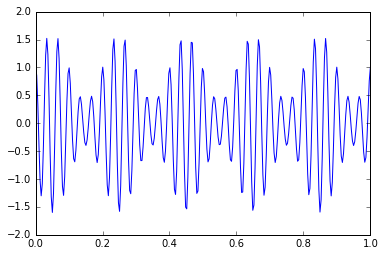

In [26]:
s = np.linspace(0,1,300)
tremolo = 1+0.6*sin(2*pi*5*s)
plt.plot(s,tremolo*cos(2*pi*30*s))

In [49]:
BaseNote = 440
depth = 0.6
tremfreq = 8

amsound = []
for note in mary:
    fnum, dur = note
    t = np.linspace(0,dur,dur*Fs)
    tremolo = 1 + depth*sin(2*pi*tremfreq*t)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = cos(2*pi*f*t)
    amsound.append(guitar_env(t)  * tremolo * sinusoid)
    
amsound = np.concatenate(amsound)
Audio(amsound, rate=Fs)

In [50]:
sound = amsound+0.5*mary_flute_sound
Audio(sound, rate=Fs)

In [35]:
# Boardcasted by FM 
BaseNote = 466.16
amp=0.5
fm=4.1
am=1
sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid =  cos(2*pi*f*t +am*amp *sin(fm*pi*f*t))
    sound.append(guitar_env(t) * sinusoid)
train_fm_guitar_sound = np.concatenate(sound)


sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t + am*amp*sin(fm*f*t))
    sound.append(flute_env(t) * sinusoid)
    
train_fm_flute_sound= np.concatenate(sound)
train_fm_duo_sound = 0.3*train_fm_guitar_gsound+1*train_fm_flute_sound

Audio(train_fm_duo_sound, rate=Fs)

In [36]:
# Boardcasted by AM 
BaseNote = 466.16
depth = 0.6
tremfreq = 8

sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    tremolo = 1 + depth*sin(2*pi*tremfreq*t)
    sinusoid =  cos(2*pi*f*t )
    sound.append(guitar_env(t)*tremolo * sinusoid)
train_am_guitar_sound = np.concatenate(sound)

sound = []
for note in train:
    fnum, dur = note
    dur=dur/2
    t = np.linspace(0,dur,dur*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    tremolo = 1 + depth*sin(2*pi*tremfreq*t)
    sinusoid = sin(2*pi*f*t)
    sound.append(flute_env(t) *tremolo* sinusoid)
    
train_am_flute_sound = np.concatenate(sound)
train_am_duo_sound = 0.3*train_am_guitar_sound+train_am_flute_sound

Audio(train_am_duo_sound , rate=Fs)

Exercise
---
As a famous DJ like you, try to play your song in the tune.

In [ ]:
song=[]
BaseNote = # e.g.466.16

sound = []
for note in song:
    fnum, dur = note
    t = np.linspace(0,dur/2,dur/2*Fs)
    f = BaseNote * 2**((fnum-69)/12)
    sinusoid = sin(2*pi*f*t)
    #sound.append(guitar_env(t) * sinusoid)
    sound.append(flute_env(t) * sinusoid)
your_sound = np.concatenate(sound)

Audio(your_sound, rate=Fs)

Golden Ear
---
As well-known, the sound within
  ```
    20Hz ~ 20k Hz
  ```
are heard by human being.    The more ages, the less sound range we can hear.

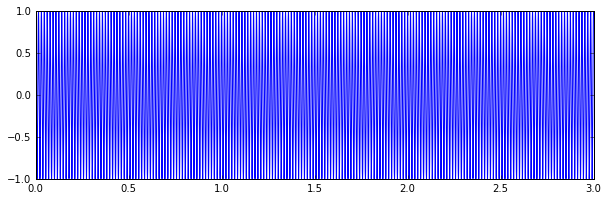

In [37]:
# Let's play some sounds.  First, A above middle C:
plt.figure(figsize=(10,3))
Fs = 44100 #samplerate
dur = 3 #note duration in seconds
t = np.linspace(0,dur,dur*Fs)

#plt.plot(t, cos(2*pi*f*t) ) 
f = 64
plt.plot(t, cos(2*pi*f*t)) 
Audio(cos(2*pi*f*t), rate=Fs)

In [38]:
def SoundRange(freq):
    
    plt.figure(figsize=(10,3))
    Fs = 44100 #samplerate
    dur = 3 #note duration in seconds
    t = np.linspace(0,dur,dur*Fs)

    #plt.plot(t, cos(2*pi*f*t) ) 
    f = freq
    return Audio(cos(2*pi*f*t), rate=Fs)
    #return plt.plot(t, cos(2*pi*f*t)),Audio(cos(2*pi*f*t), rate=Fs)

In [39]:
freq=200

Fs=44100
SoundRange(freq)
t = np.linspace(0,3,3*Fs)
Audio(cos(2*pi*freq*t), rate=Fs)

Test how old yoy are
---

In [40]:
from ipywidgets import interact, FloatSlider
interact(SoundRange, freq=FloatSlider(min=20, max=20000,step=1000))

In [1]:
!jupyter nbconvert --to html Sinusoid.ipynb

[NbConvertApp] Converting notebook Sinusoid.ipynb to html
[NbConvertApp] Writing 34459662 bytes to Sinusoid.html
